In [1]:
import matplotlib.animation as animation
import mplfinance as mpf
import yfinance as yf

from IPython.display import HTML

from backtest import *
from technical_analysis import *
from utils import *

In [3]:
ticker = 'AAPL'
start = '2022-01-01'
period = '1d'
interval = '5m'

df = yf.download(tickers=ticker, start=start, period=period, interval=interval)
df.columns = df.columns.str.lower()
df

[*********************100%***********************]  1 of 1 completed


,open,high,low,close,adj close,volume
Datetime,,,,,,
2021-12-31 11:00:00-05:00,178.390793,178.419998,178.214996,178.320007,178.320007,0
2021-12-31 11:05:00-05:00,178.319199,178.324997,178.000000,178.160004,178.160004,506761
2021-12-31 11:10:00-05:00,178.169998,178.299301,178.053406,178.119995,178.119995,447441
2021-12-31 11:15:00-05:00,178.119995,178.139999,178.020096,178.087906,178.087906,401529
2021-12-31 11:20:00-05:00,178.080002,178.229996,178.070007,178.169006,178.169006,395329
...,...,...,...,...,...,...
2022-02-11 12:25:00-05:00,171.589996,171.940002,171.535004,171.804993,171.804993,315995
2022-02-11 12:30:00-05:00,171.800003,172.029999,171.729996,171.884995,171.884995,475585
2022-02-11 12:35:00-05:00,171.880005,172.070007,171.766006,171.869995,171.869995,553169


[色碼表](https://www.ifreesite.com/color/)

In [11]:
color = mpf.make_marketcolors(up='#FF0000', down='#00FF00', inherit=True)
style = mpf.make_mpf_style(base_mpf_style='nightclouds', marketcolors=color)
kwargs = dict(
    type='candle',
    volume=True,
    style=style,
    mav=[5, 10, 20],
)

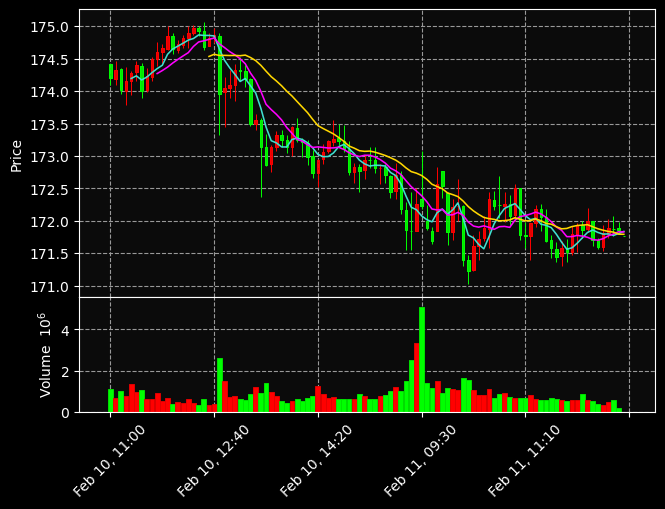

In [12]:
mpf.plot(df[-100:], **kwargs)

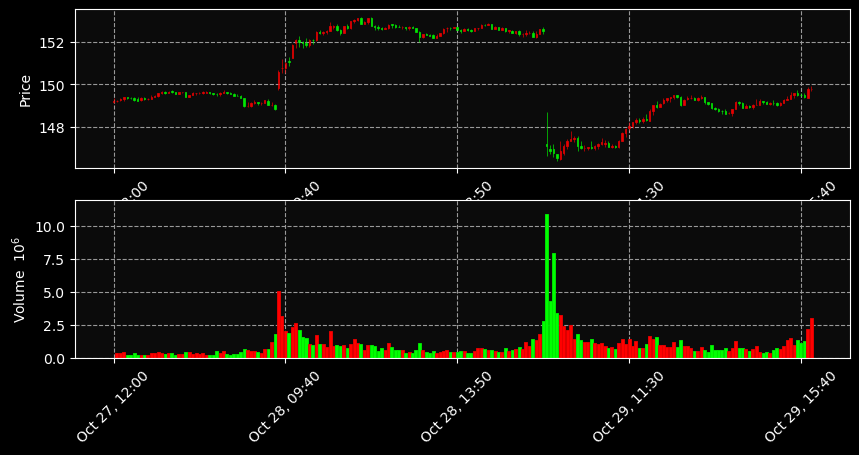

In [5]:
# add your own style by passing in kwargs    
color = mpf.make_marketcolors(up='#FF0000', down='#00FF00', inherit=True)
style = mpf.make_mpf_style(base_mpf_style='nightclouds', marketcolors=color)

# pass in the self defined style to the whole canvas
fig = mpf.figure(figsize=(10, 7), style=style) 
# main candle stick chart subplot, you can also pass in the self defined style here only for this subplot
ax = fig.add_subplot(3,1,1) 
av = fig.add_subplot(3,1,2, sharex=ax)  # volume chart subplot
mpf.plot(df, type='candle', ax=ax, volume=av)

# animation

In [6]:
%matplotlib
mpf.plot(df, **kwargs)

Using matplotlib backend: Qt5Agg


In [7]:
%matplotlib
data_interval = 40
_kwargs = dict(type='candle', volume=True, style=style, mav=[5, 10, 20])
fig, ax = mpf.plot(df.iloc[:data_interval], returnfig=True, **_kwargs)

ax1 = ax[0]
ax2 = ax[2]

def animate(i):
    _df = df.iloc[i:i+data_interval]
    ax1.clear()
    ax2.clear()
    _kwargs = dict(type='candle', style=style, mav=[5, 10, 20])
    _fig = mpf.plot(_df, ax=ax1, volume=ax2, **_kwargs)
    return _fig,
    
ani = animation.FuncAnimation(fig, animate, interval=100)

Using matplotlib backend: Qt5Agg


In [8]:
HTML(ani.to_jshtml())

會發現如果使用內建的sma_func只會使用當前frame的資料做sma

# add plot

[example](https://github.com/matplotlib/mplfinance/blob/master/examples/addplot.ipynb)

In [9]:
%matplotlib inline

In [10]:
color = mpf.make_marketcolors(up='#FF0000', down='#00FF00', inherit=True)
style = mpf.make_mpf_style(base_mpf_style='nightclouds', marketcolors=color)
kwargs = dict(
    type='candle',
    volume=True,
    style=style,
    mav=[5, 10, 20],
)

In [11]:
df = cal_sma(df, 'close', [5, 10, 20])

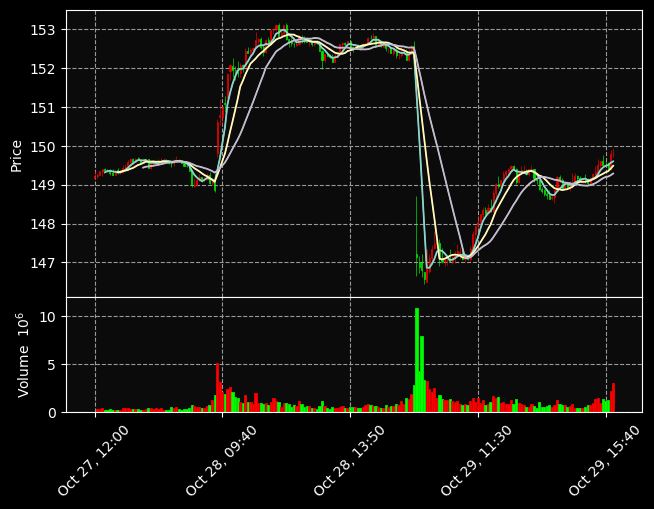

In [12]:
apdict = mpf.make_addplot(df[['ma5', 'ma10', 'ma20']])
mpf.plot(df, addplot=apdict, **kwargs)

In [33]:
def cal_bbands(df, days:(int, list)=20, k:(float, int)=2, *args, **kwargs):
    '''
    calculate Bollinger Bands
    
    return:
         bbands' upper, lower, percent b (PB), bandwidth
    '''
    
    bbands_params = kwargs.get('bbands_params', {})
    days = bbands_params.get('days', days)
    k = bbands_params.get('k', k)    
    esp = bbands_params.get('esp', 1e-8)
    append = kwargs.get('append', True)
    
    sma = cal_moving_func(df.close, days, 'mean', 'sma')
    std = cal_moving_func(df.close, days, 'std', 'sma')
    
    upper = sma + k * std
    lower = sma - k * std
    
    pb = (df.close - lower) / (upper - lower)
    #bandwidth = (upper - lower) / sma
    bandwidth = 2 * k * std / sma
    
    if append:
        df['b_upper'] = upper
        df['b_lower'] = lower
        df['b_percent'] = pb
        df['b_bw'] = bandwidth
        return df
    else:
        return upper, lower, pb, bandwidth

def cal_hlc3(df, *args, **kwargs):
    hlc3_params = kwargs.get('hlc3_params', {})
    append = kwargs.get('append', True)
    
    hlc3 = df[['open', 'low', 'close']].mean(axis=1)
    
    if append:
        df['hlc3'] = hlc3
        return df
    else:
        return hlc3

def cal_vwap(df, anchor='min', *args, **kwargs):
    '''
    anchor (str): 
        
        https://pandas.pydata.org/pandas-docs/stable/user_guide/timeseries.html#timeseries-offset-aliases

        D: calendar day frequency

        W: weekly frequency

        M: month end frequency    

        H hourly frequency

        T, min minutely frequency

        S secondly frequency

        L, ms milliseconds
        
        Default: 'min'
    '''
    vwap_params = kwargs.get('vwap_params', {})
    anchor = vwap_params.get('anchor', anchor)
    esp = vwap_params.get('esp', 1e-8)
    
    typical_price = df[['open', 'low', 'close']].mean(axis=1)
    wp = (typical_price * df.volume)
    vwap  = wp.groupby(wp.index.to_period(anchor)).cumsum()
    vwap /= df.volume.groupby(df.index.to_period(anchor)).cumsum()
    df['vwap'] = vwap
    return df

In [15]:
df = (
    df.pipe(cal_bbands)
      .pipe(cal_sma, 'volume', [5, 10, 20], suffix='_v')
      .pipe(cal_vwap, '30min')
)

We refer to the Main, Upper panel as Panel 0 and the Lower panel as Panel 1.

It is possible to plot the additional data on Panel 1 (where Volume is usually plotted).

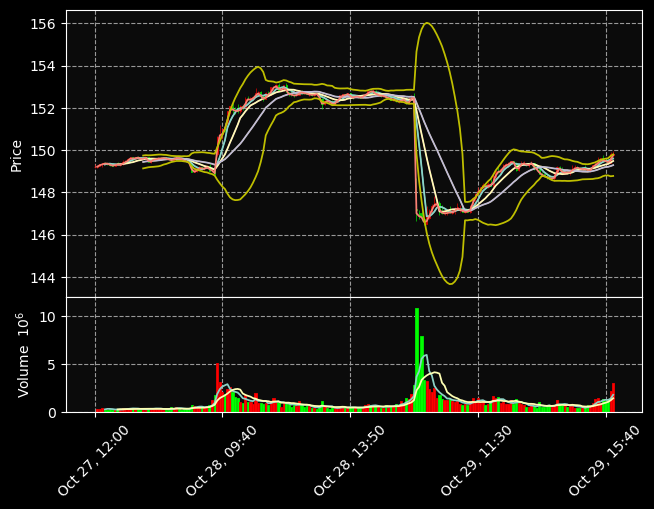

In [16]:
apds = [
    mpf.make_addplot(df[['ma5', 'ma10', 'ma20']]),
    mpf.make_addplot(df['vwap']),
    mpf.make_addplot((df[['b_upper', 'b_lower']]), color='y'),
    mpf.make_addplot((df[['ma5_v', 'ma10_v']]), panel=1),
]
mpf.plot(df, addplot=apds, **kwargs)

## show_nontrading

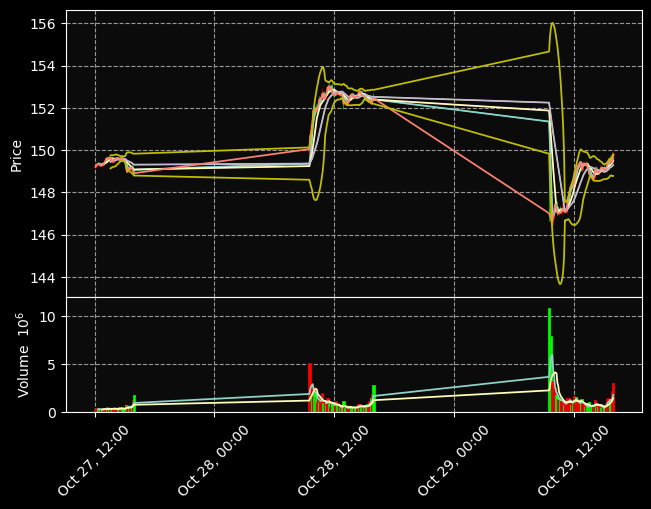

In [17]:
apds = [
    mpf.make_addplot(df[['ma5', 'ma10', 'ma20']]),
    mpf.make_addplot(df['vwap']),
    mpf.make_addplot((df[['b_upper', 'b_lower']]), color='y'),
    mpf.make_addplot((df[['ma5_v', 'ma10_v']]), panel=1),
]
mpf.plot(df, addplot=apds, show_nontrading=True, **kwargs)

## animation

In [19]:
%matplotlib

data_interval = 40
_kwargs = dict(type='candle', style=style)
_apdict = [
    mpf.make_addplot(df[['ma5', 'ma10', 'ma20']].iloc[:data_interval], 
                     width=0.75),
    mpf.make_addplot((df[['b_upper', 'b_lower']]).iloc[:data_interval], 
                     color='y'),
    mpf.make_addplot((df[['ma5_v', 'ma10_v']]).iloc[:data_interval], 
                     width=0.75, 
                     panel=1),    
]

fig, axes = mpf.plot(df.iloc[:data_interval], 
                   volume=True, 
                   returnfig=True, 
                   addplot=_apdict, 
                   **_kwargs)


def animate(i):
    _df = df.iloc[i:i+data_interval]
    _apdict = [
        mpf.make_addplot(df[['ma5', 'ma10', 'ma20']].iloc[i:i+data_interval], 
                         width=0.75,
                         ax=axes[0],
                         ),
        mpf.make_addplot((df[['b_upper', 'b_lower']]).iloc[i:i+data_interval], 
                         color='y',
                         ax=axes[0]),
        mpf.make_addplot((df[['ma5_v', 'ma10_v']]).iloc[i:i+data_interval], 
                         width=0.75, 
                         panel=1,
                         ax=axes[2]),    
    ]
    
    for ax in axes:
        ax.clear()
        
    _fig = mpf.plot(_df, ax=axes[0], volume=axes[2],  addplot=_apdict, **_kwargs)
    return _fig,
    
ani = animation.FuncAnimation(fig, animate, interval=100)

Using matplotlib backend: Qt5Agg


In [20]:
HTML(ani.to_jshtml())

# annotation

In [24]:
%matplotlib inline

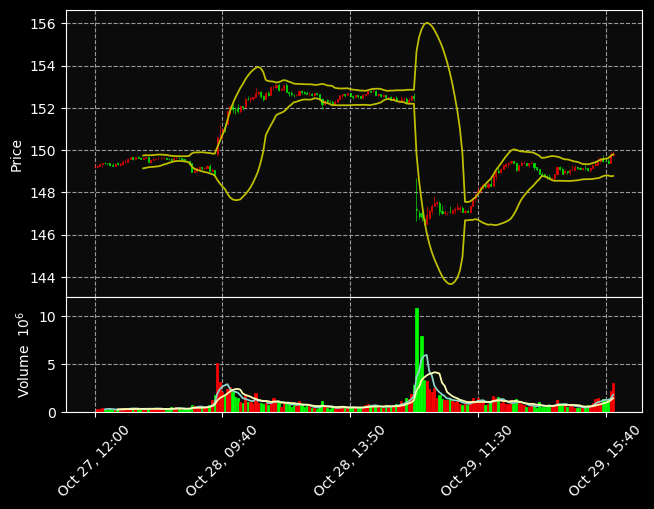

In [26]:
apds = [
    mpf.make_addplot((df[['b_upper', 'b_lower']]), color='y'),
    mpf.make_addplot((df[['ma5_v', 'ma10_v']]), panel=1),
]
kwargs = dict(type='candle', volume=True, style=style)
mpf.plot(df, addplot=apds, **kwargs)

In [91]:
lower_signal = pd.Series(data=np.nan, index=df.index)
condition = df[(df.b_percent >= 0).shift(1) & (df.b_percent < 0).astype(bool)]
lower_signal.loc[condition.index] = condition.close * 0.99

upper_signal = pd.Series(data=np.nan, index=df.index)
condition = df[(df.b_percent <= 0).shift(1) & (df.b_percent > 0).astype(bool)]
upper_signal.loc[condition.index] = condition.close * 1.01

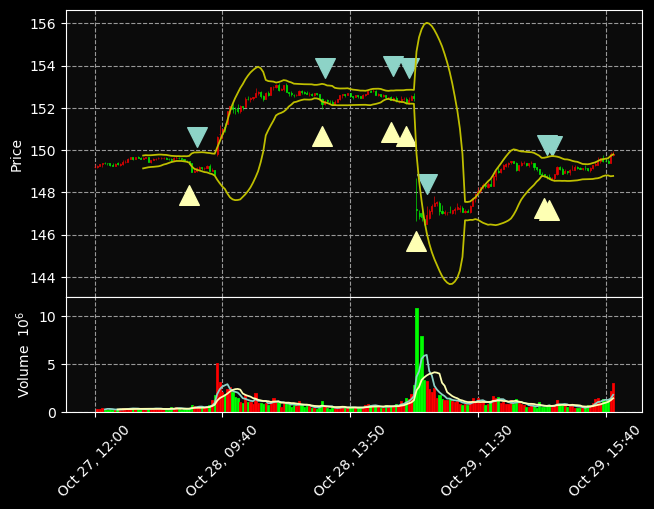

In [103]:
apds = [
    mpf.make_addplot(upper_signal, type='scatter', markersize=200, marker='v'),
    mpf.make_addplot(lower_signal, type='scatter', markersize=200, marker='^'),
    mpf.make_addplot((df[['b_upper', 'b_lower']]), color='y'),
    mpf.make_addplot((df[['ma5_v', 'ma10_v']]), panel=1),
]
kwargs = dict(type='candle', volume=True, style=style)
mpf.plot(df, addplot=apds, **kwargs)

畫符號時，假如區間內全都是nan，就不讓人畫

In [144]:
%matplotlib
def _add_arrow(_apdict, upper_signal, lower_signal, data_interval, i=0, ax=None):
    params = dict(type='scatter', markersize=200)
    if ax is not None:
        params['ax'] = ax
    
    _upper_signal = upper_signal.iloc[i:i+data_interval]
    _lower_signal = lower_signal.iloc[i:i+data_interval]
    
    if not _upper_signal.isna().all():
        params['data'] =_upper_signal
        params['marker'] = 'v'
        _apdict.append(mpf.make_addplot(**params))
    if not _lower_signal.isna().all():
        params['data'] =_lower_signal
        params['marker'] = '^'        
        _apdict.append(mpf.make_addplot(**params))
    return _apdict

data_interval = 40
_kwargs = dict(type='candle', style=style)
_apdict = [
    mpf.make_addplot((df[['b_upper', 'b_lower']]).iloc[:data_interval], color='y'),
    mpf.make_addplot((df[['ma5_v', 'ma10_v']]).iloc[:data_interval], width=0.75, panel=1),    
]
_apdict = _add_arrow(_apdict, upper_signal, lower_signal, data_interval)

fig, axes = mpf.plot(df.iloc[:data_interval], 
                   volume=True, 
                   returnfig=True, 
                   addplot=_apdict, 
                   **_kwargs)


def animate(i):
    for ax in axes:
        ax.clear()
        
    _apdict = [       
        mpf.make_addplot((df[['b_upper', 'b_lower']]).iloc[i:i+data_interval], 
                         color='y',
                         ax=axes[0]),
        mpf.make_addplot((df[['ma5_v', 'ma10_v']]).iloc[i:i+data_interval], 
                         width=0.75, 
                         panel=1,
                         ax=axes[2]),    
    ]
    _apdict = _add_arrow(_apdict, upper_signal, lower_signal, data_interval, i, axes[0])
        
    _df = df.iloc[i:i+data_interval]    
    _fig = mpf.plot(_df, ax=axes[0], volume=axes[2],  addplot=_apdict, **_kwargs)
    return _fig,

ani = animation.FuncAnimation(fig, animate, interval=100)

Using matplotlib backend: Qt5Agg


In [145]:
HTML(ani.to_jshtml())